In [1]:
%load_ext autoreload
%autoreload 2
# imports
import logging
import sys, os
import time
from tf_pose import common
import cv2
import numpy as np
from tf_pose.estimator import TfPoseEstimator, PoseEstimator
from tf_pose.networks import get_graph_path, model_wh
from tf_pose.common import CocoPart, CocoPairsRender, CocoPairsNetwork
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import asyncio
import datetime
import random
import io

import http.server
import socketserver
import threading
from IPython.display import IFrame
import base64
from PIL import Image
from io import BytesIO
import re
from utils import plot_pose, get_humans_as_lines, plot_human_lines, is_same_image
import tensorflow as tf
import math
import copy
from tqdm import tqdm
import datetime
import pathlib
sys.path.insert(0, os.path.abspath('..'))

from tf_pose.tensblur.smoother import Smoother


os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
logging.getLogger("tensorflow").setLevel(logging.CRITICAL)
logging.getLogger('TfPoseEstimatorRun').setLevel(logging.ERROR)
logging.getLogger('DeepExplain').setLevel(logging.ERROR)
logging.getLogger('TfPoseEstimator').setLevel(logging.ERROR)

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.




In [2]:
# the target state
# the loss defined in the paper
def multi_stage_loss(target_heat, target_paf, start_stage=2):
    losses_per_stage = []
    # compute loss per stage
    for stage in range(start_stage, 7): 
        paf_op = estimator.graph.get_operation_by_name(f'TfPoseEstimator/Mconv7_stage{stage}_L1/BiasAdd').outputs[0]
        heat_op = estimator.graph.get_operation_by_name(f'TfPoseEstimator/Mconv7_stage{stage}_L2/BiasAdd').outputs[0]

        # compute the loss for every channel
        loss_paf = tf.nn.l2_loss(tf.concat(paf_op, axis=-1) - tf.concat(target_paf, axis=-1), name='AX_loss_l1_stage%d_' % (stage))
        loss_heat = tf.nn.l2_loss(tf.concat(heat_op, axis=-1) - tf.concat(target_heat, axis=-1), name='AX_loss_l2_stage%d_' % (stage))
        losses_per_stage.append(tf.reduce_sum([loss_paf, loss_heat]))

    # combined loss form every stage
    total_loss = tf.reduce_sum(losses_per_stage)
    summary = tf.summary.scalar('grad_norm', total_loss)

    grad = tf.gradients(total_loss, estimator.tensor_image)[0]
    return grad, summary

def multi_stage_loss_batch(target_heat, target_paf, start_stage=2):
    losses_per_stage = []
    # compute loss per stage
    for stage in range(start_stage, 7): 
        paf_op = estimator.graph.get_operation_by_name(f'TfPoseEstimator/Mconv7_stage{stage}_L1/BiasAdd').outputs[0]
        heat_op = estimator.graph.get_operation_by_name(f'TfPoseEstimator/Mconv7_stage{stage}_L2/BiasAdd').outputs[0]

        # compute the loss for every channel
        loss_paf = tf.nn.l2_loss(tf.concat(paf_op, axis=-1) - tf.concat(target_paf, axis=-1), name='AX_loss_l1_stage%d_' % (stage))
        loss_heat = tf.nn.l2_loss(tf.concat(heat_op, axis=-1) - tf.concat(target_heat, axis=-1), name='AX_loss_l2_stage%d_' % (stage))
        losses_per_stage.append(tf.reduce_sum([loss_paf, loss_heat]))

    # combined loss form every stage
    total_loss = tf.reduce_sum(losses_per_stage)
    summary = tf.summary.scalar('batch_loss', total_loss)

    grad = tf.gradients(total_loss, estimator.tensor_image)[0]
    # compute the average 
    grad = tf.reduce_mean(grad, 0)
    return grad, summary

def print_image_Stats(img):
    print(f'Min: {np.min(img)}')
    print(f'Max: {np.max(img)}')
    print(f'Avg: {np.average(img)}')

# compare two pose and return the total diff and the part switch moved the most
def compare_poses(pose1, pose2):
    total_diff = 0
    cur_max = 0
    most_moved_part = ''
    if(len(pose1.body_parts) != len(pose2.body_parts)):
        print('Poses have different length of body parts')
        return 0, 'NONE'
    for i in pose1.body_parts.keys():
        part1 = pose1.body_parts[i]
        part2 = pose2.body_parts[i]
        part1_pos =  np.array([part1.x, part1.y])
        part2_pos =  np.array([part2.x, part2.y])
        cur_diff = np.linalg.norm(part1_pos - part2_pos)
        if cur_diff > cur_max:
            most_moved_part = part1.get_part_name()
            cur_max = cur_diff
        total_diff += cur_diff
    return total_diff, most_moved_part

# compute the distance of a join between two poses
def compute_distance(pose1, pose2, index):
    if index not in pose1.body_parts or index not in pose2.body_parts:
        print(f'{index} not in both poses found')
        return 0
    part1 = pose1.body_parts[index]
    part2 = pose2.body_parts[index]
    part1_pos =  np.array([part1.x, part1.y])
    part2_pos =  np.array([part2.x, part2.y])
    return np.linalg.norm(part1_pos - part2_pos)

def gen_plot(human_source, human_target, human_adv):
    source_lines = get_humans_as_lines(human_source, 400, 450)
    target_lines = get_humans_as_lines(human_target, 400, 450)
    adv_lines = get_humans_as_lines(human_adv, 400, 450)

    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(1, 1, 1)

    plot_human_lines(source_lines, ax, color='r', linestyle='-', label='source')
    plot_human_lines(target_lines, ax, color='g', linestyle='-', label='target')
    plot_human_lines(adv_lines, ax, color='b', linestyle='--', label='adv')

    legend_elements = [Line2D([0], [0], color='r', label='source'),
                       Line2D([0], [0], color='g', label='target'),
                       Line2D([0], [0], color='b', label='adverserial')]
    ax.legend(handles=legend_elements, loc='best',  prop={'size': 20})
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    buf.seek(0)
    return buf

def gen_plot_universal_noise(noise, index=None):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(1, 1, 1)
    ax.imshow(np.clip(noise, 0, 255) / 255)
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    buf.seek(0)
    if index != None:
        plt.savefig(f'logs/gif/{i}.png', format='png')
    return buf

def load_batch(training_paths, start_index, batch_size, width=432, height=368):
    i = start_index
    batch = []
    while len(batch) < batch_size:
        if i >= len(training_paths):
            i = 0
        batch.append(common.read_imgfile(str(training_paths[i]), width, height))
        i += 1
    return np.asarray(batch), i

In [3]:
# params 432, 368
w, h = 432, 368
image_path_target = 'data/images/dri_target_far_2.jpg'
train_dir = 'data/cocoval2017Humans/train'
test_dir = 'data/cocoval2017Humans/test'
model = 'cmu'
log_dir = 'logs/'


resize_out_ratio = 2.0
image_target = common.read_imgfile(image_path_target, w, h)
summary_writer = tf.summary.FileWriter(log_dir + "uniadv/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
training_paths = pathlib.Path(train_dir).glob('*.jpg')
training_paths = sorted([x for x in training_paths])
test_paths = pathlib.Path(test_dir).glob('*.jpg')
test_paths = sorted([x for x in test_paths])

In [4]:
estimator = TfPoseEstimator(get_graph_path(model), target_size=(w, h), trt_bool=False)
upsample_size = [int(estimator.target_size[1] / 8 * resize_out_ratio), int(estimator.target_size[0] / 8 * resize_out_ratio)]
# get all outputs as np matrix
target_np, target_np_heat, target_np_paf, target_np_peaks = estimator.persistent_sess.run(
            [estimator.tensor_output, estimator.tensor_heatMat_up, estimator.tensor_pafMat_up, estimator.tensor_peaks],
            feed_dict={
                estimator.tensor_image: [image_target],
                estimator.upsample_size: upsample_size
            }
        )

In [5]:
training_stats = {}
training_stats['universal_noise'] = np.load('snapshots/op_universal_noise_20200205-145237.npy')

Min: 0.0
Max: 255.0
Avg: 22.934496779482156


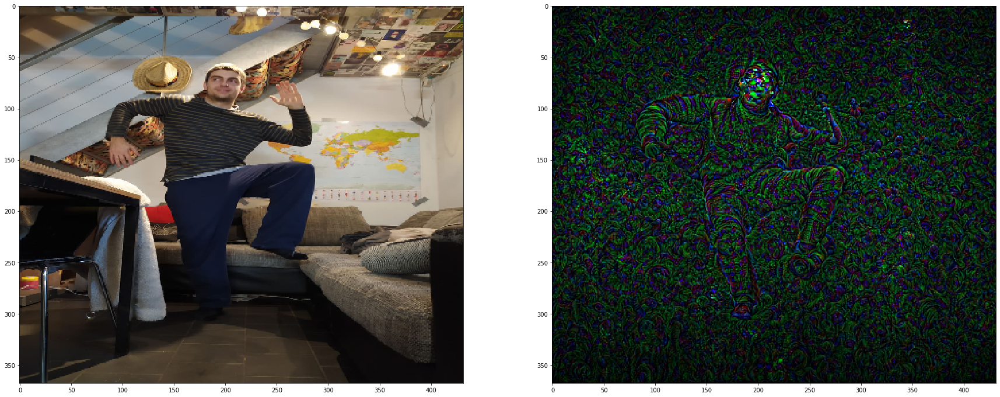

In [6]:
print_image_Stats(training_stats['universal_noise'])
fig = plt.figure(figsize=(30, 30))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(cv2.cvtColor(image_target, cv2.COLOR_BGR2RGB))
ax = fig.add_subplot(1, 2, 2)
ax.imshow(np.clip(training_stats['universal_noise'], 0, 255) / 255)

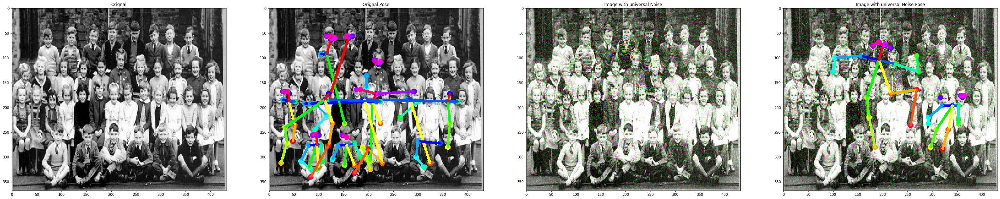

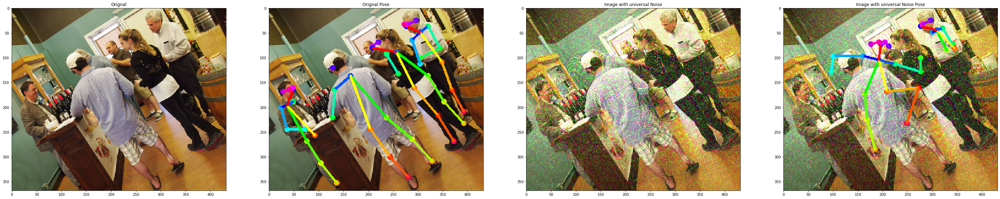

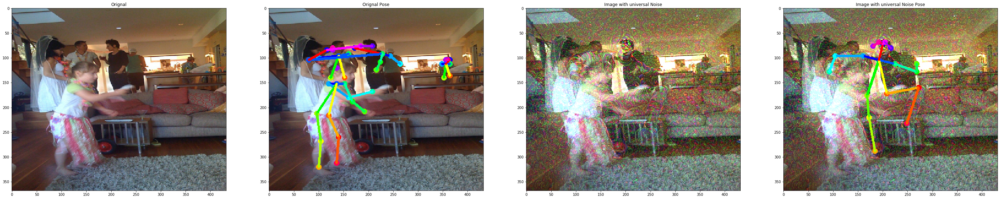

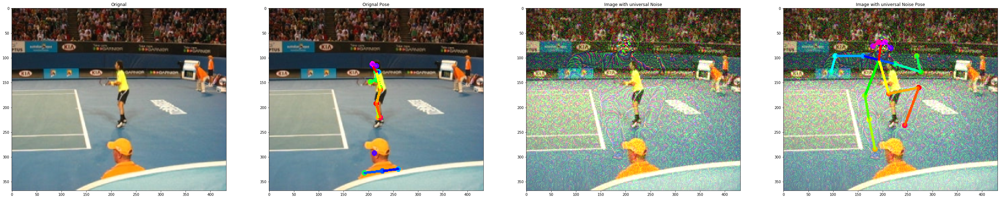

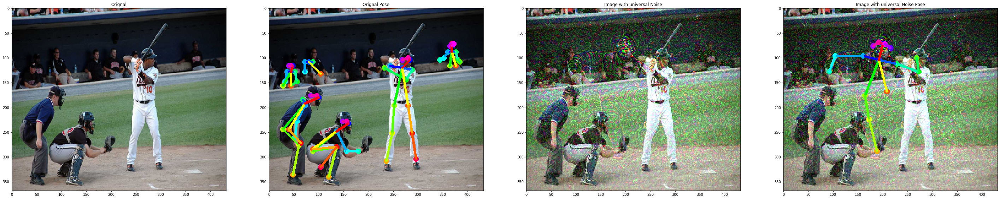

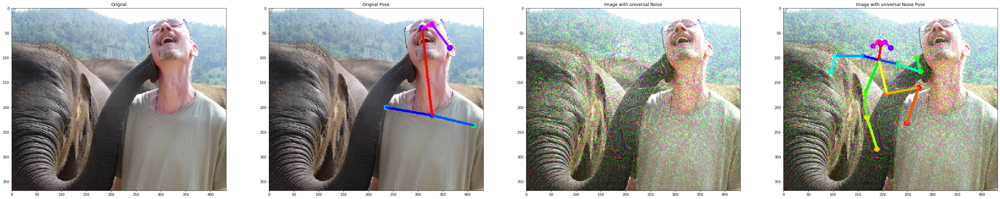

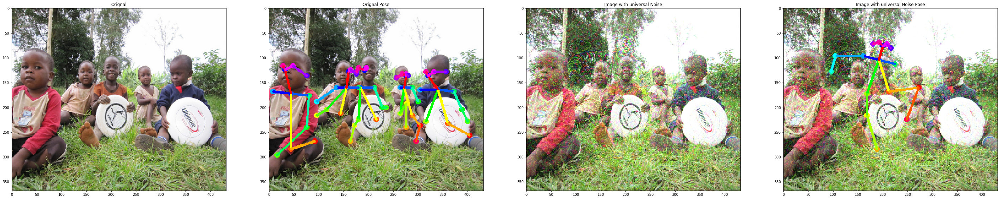

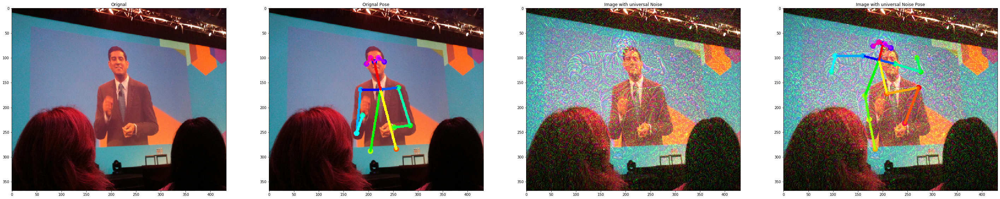

In [7]:
BATCH_SIZE = 8
batch, batch_index = load_batch(test_paths, 0, BATCH_SIZE)


for i, image in enumerate(batch):
    test_image = np.clip(image + training_stats['universal_noise'], 0, 255) 
    detections = estimator.inference(image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = estimator.inference(test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    #plot_pose(test_image.astype(np.float32) / 255.0, detections, estimator.heatMat)
    
    detections_result = TfPoseEstimator.draw_humans(image, detections, imgcopy=True)
    detections_uni = TfPoseEstimator.draw_humans(test_image, detections_uni, imgcopy=True)

    fig = plt.figure(figsize=(50, 25))
    ax = fig.add_subplot(1, 4, 1)
    ax.set_title('Orignal')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    
    ax = fig.add_subplot(1, 4, 2)
    ax.set_title('Orignal Pose')
    plt.imshow(cv2.cvtColor(detections_result, cv2.COLOR_BGR2RGB))
    
    ax = fig.add_subplot(1, 4, 3)
    ax.set_title('Image with universal Noise')
    plt.imshow(cv2.cvtColor(test_image.astype(np.float32) / 255.0, cv2.COLOR_BGR2RGB))
    
    ax = fig.add_subplot(1, 4, 4)
    ax.set_title('Image with universal Noise Pose')
    plt.imshow(cv2.cvtColor(detections_uni.astype(np.float32) / 255.0, cv2.COLOR_BGR2RGB))

    

In [8]:
sys.path.insert(0, os.path.abspath('..'))
# Import DeepExplain
from deepexplain.tf.v1_x import DeepExplain

# set the test
universal_noise_batch = np.expand_dims(training_stats['universal_noise'], 0)
universal_noise_batch = np.repeat(universal_noise_batch, BATCH_SIZE, 0)
test_batch = np.clip(batch + universal_noise_batch, 0, 255) 

ATTRIBUTION_PART = CocoPart.RWrist.value

with DeepExplain(session=estimator.persistent_sess, graph=estimator.graph) as de:
    input_tensor = estimator.tensor_image
    output_tensor = estimator.tensor_heatMat[:, :, :, ATTRIBUTION_PART]
    # input
    xs = test_batch # tf.expand_dims(test_image, 0).eval(session=estimator.persistent_sess)
    
    Y_shape=[None] + [1, 46, 54] # size of heatmaps with resize
    ys = np.ones([BATCH_SIZE,] + Y_shape[1:])
    #ys = np.expand_dims(np.expand_dims(mask, axis=0), axis=0)
    # print(Y_shape)
    #baseline = np.zeros(list(xs.shape)[1:]) # baseline to compare against

    attributions = {
        'Saliency maps':        de.explain('saliency', T=output_tensor, X=input_tensor, xs=xs, ys=ys, Y_shape=Y_shape),
        'Gradient * Input':     de.explain('grad*input', T=output_tensor, X=input_tensor, xs=xs, ys=ys, Y_shape=Y_shape),
    }

Using tf version = 1.15.0


/home/ax/miniconda3/envs/masterThesis/lib/python3.6/site-packages/skimage/transform/_warps.py:23: UserWarning: The default multichannel argument (None) is deprecated.  Please specify either True or False explicitly.  multichannel will default to False starting with release 0.16.
  warn('The default multichannel argument (None) is deprecated.  Please '


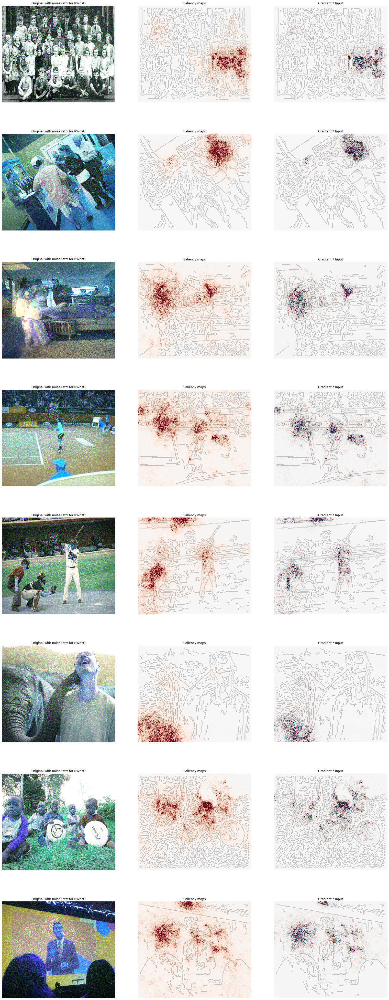

In [9]:
# Plot attributions
from utils import plot, plt
%matplotlib inline

n_cols = int(len(attributions)) + 1
n_rows = len(xs) 
fig_scale = 3
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(3*n_cols*fig_scale, 3*n_rows*fig_scale))

for i, xi in enumerate(xs):    
    xi = (xi - np.min(xi)).astype(np.float64)
    xi /= np.max(xi)
    ax = axes.flatten()[i*n_cols]
    ax.imshow(xi)
    ax.set_title(f'Original with noise (attr for {CocoPart(ATTRIBUTION_PART).name})')
    ax.axis('off')
    for j, a in enumerate(attributions):
        axj = axes.flatten()[i*n_cols + j + 1]
        plot(attributions[a][i], xi = xi, axis=axj, dilation=.5, percentile=99, alpha=.2).set_title(a)